In [3]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
%matplotlib inline
import plotly.offline as pyo
import plotly.graph_objs as go
import warnings
warnings.simplefilter("ignore")
warnings.filterwarnings("ignore")
%config InlineBackend.figure_format = "retina"
import seaborn as sns
sns.set_style("whitegrid")
sns.set_context("talk")
sns.set(rc={"figure.figsize":(10,8)})

In [4]:
%load_ext tensorboard
import tensorflow as tf
fashion_mnist = tf.keras.datasets.fashion_mnist
(X_train, y_train), (X_test, y_test) = fashion_mnist.load_data()

In [5]:
X_train, X_test = X_train.reshape(-1,28,28,1) / 255.0 , X_test.reshape(-1,28,28,1) / 255.0

Text(0.5, 1.05, 'Fashion MNIST Dataset')

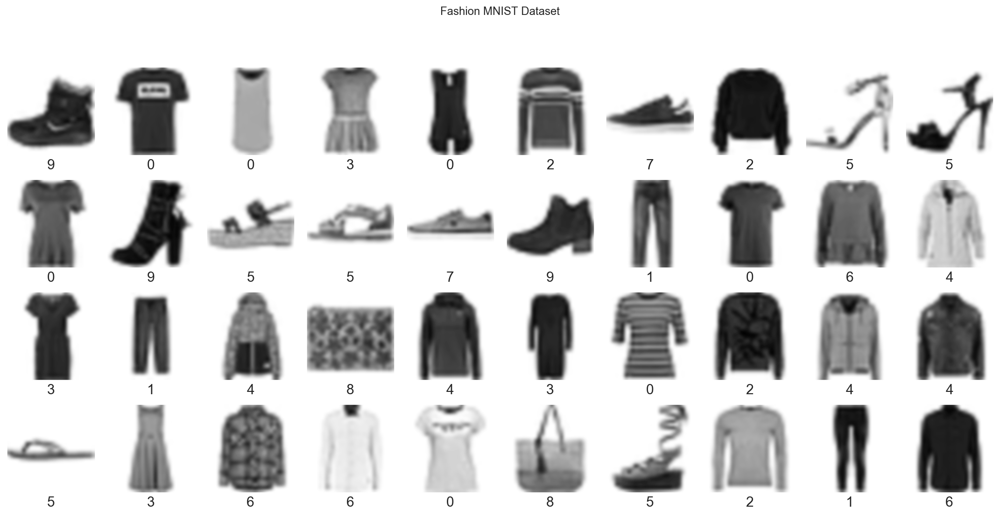

In [6]:
plt.figure(figsize=(15,15))
for i in range(0,40):
    plt.subplot(9,10,i + 1)
    grid_data = X_train[i].squeeze()
    plt.imshow(grid_data, interpolation = "bicubic", cmap = plt.cm.binary)
    plt.xticks([])
    plt.yticks([])
    plt.grid(True)
    plt.xlabel(y_train[i],fontsize=15)
plt.tight_layout()
plt.suptitle('Fashion MNIST Dataset',y=1.05)

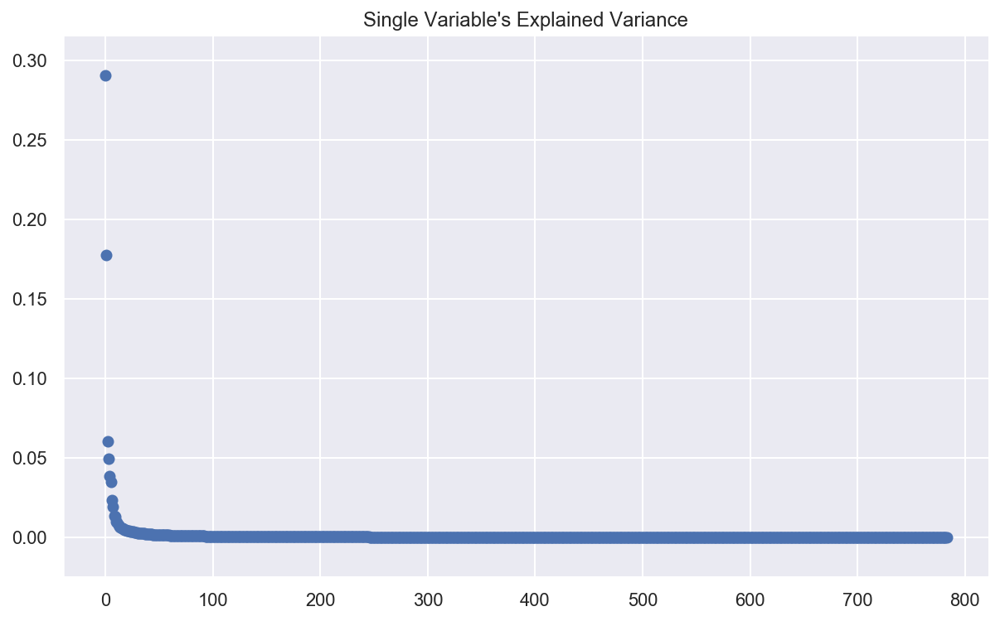

In [7]:
#determine explained variance ratio of each variables
from sklearn.decomposition import PCA
pca = PCA(n_components=784).fit(X_train.reshape(-1,784))
plt.figure(figsize=(10,6))
plt.scatter(list(range(784)), pca.explained_variance_ratio_)
plt.title("Single Variable's Explained Variance")
sns.despine(offset=0.2)

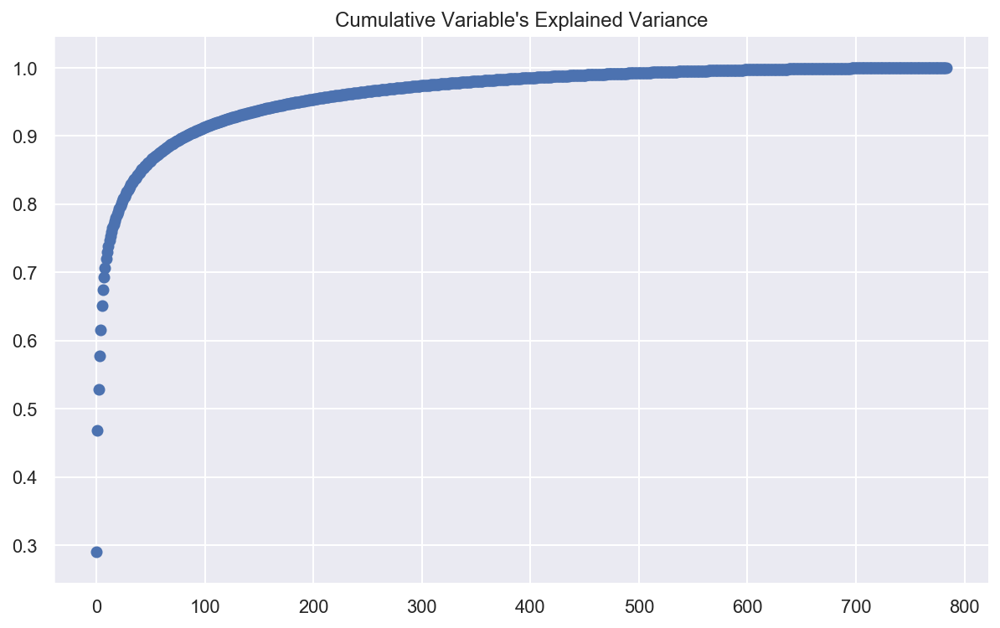

In [8]:
#determine explained variance ratio of cumulative variables
from sklearn.decomposition import PCA
pca = PCA(n_components=784).fit(X_train.reshape(-1,784))
plt.figure(figsize=(10,6))
plt.scatter(list(range(784)),pca.explained_variance_ratio_.cumsum())
plt.title("Cumulative Variable's Explained Variance")
sns.despine(offset=0.2)

[[ 1.76521515e-07  2.44768364e-06  1.67354171e-05 ...  1.06623293e-03
   1.14054578e-04  1.30759064e-05]
 [-2.00777633e-07  3.25916172e-06  7.20161624e-06 ...  2.38633309e-03
   7.40179648e-04  6.89874688e-05]
 [ 5.67039716e-07 -5.64584997e-07  1.13361831e-05 ... -5.54570529e-04
  -9.14299655e-04 -7.12402066e-05]
 ...
 [ 1.81051028e-06 -1.96706027e-06 -1.42640695e-04 ... -1.50449325e-02
  -4.95427682e-03 -3.77552981e-04]
 [-2.26090066e-06 -1.61354086e-07 -1.66752005e-05 ...  6.54538992e-03
   2.50741076e-03 -6.50000745e-05]
 [-2.02459190e-06  1.30711165e-05  5.93333800e-05 ...  7.01841128e-03
   1.87300828e-03  2.58942515e-04]]


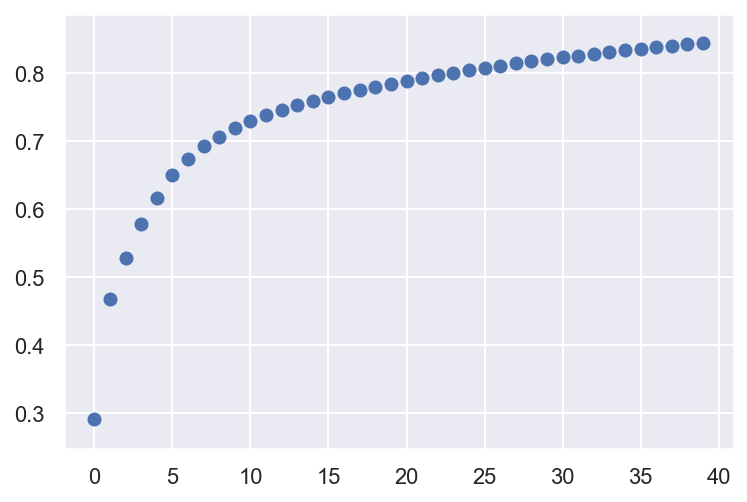

In [9]:
# Get top 40 PCA components
from sklearn.decomposition import PCA 
n_components = 40
pca = PCA(n_components=40).fit(X_train.reshape(-1,784))
plt.scatter(list(range(40)),pca.explained_variance_ratio_.cumsum())
print(pca.components_)

In [10]:
eigen_40 = pca.components_.reshape(n_components, 28, 28)

Text(0.5, 1.05, 'Top 40 Eigen Values')

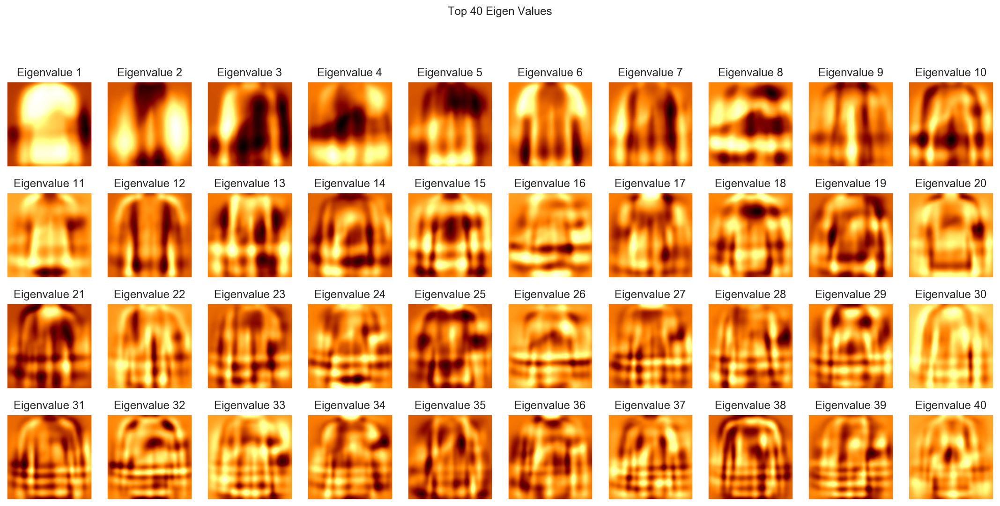

In [11]:
plt.figure(figsize=(15,15))
for i in list(range(40)):
    plt.subplot(9, 10, i + 1)
    plt.imshow(eigen_40[i], interpolation = "bicubic", cmap = "afmhot")
    title_text = 'Eigenvalue ' + str(i + 1)
    plt.title(title_text, size=12)
    plt.xticks(())
    plt.yticks(())
plt.tight_layout()
plt.suptitle('Top 40 Eigen Values',y=1.05)

### PCA

In [12]:
pca = PCA(n_components=2)
x_2 = pca.fit_transform(X_train.reshape(-1,784))

In [13]:
data = [go.Scatter(
    x = x_2[:,0],
    y = x_2[:,1],
    mode = 'markers',
    showlegend = False,
    marker = dict(
        size = 8,
        color = y_train,
        colorscale ='Rainbow',
        showscale = False,
        line = dict(
            width = 2,
            color = 'rgb(255, 255, 255)'
        ),
        opacity = 0.8
    )
)]

layout = go.Layout(
    title= 'Principal Component Analysis (PCA)',
    hovermode= 'closest',
    xaxis= dict(
        title= 'First Principal Component',
        ticklen= 8,
        zeroline= False,
        gridwidth= 2,
    ),
    yaxis=dict(
        title= 'Second Principal Component',
        ticklen= 8,
        gridwidth= 2,
    ),
    showlegend= True
)

fig = dict(data=data, layout=layout)
pyo.iplot(fig, filename='PCA_plot')

### KMeans Clustering

In [17]:
%%time
from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import accuracy_score, classification_report, confusion_matrix, adjusted_mutual_info_score

def fit_model(cluster, model=RandomForestClassifier(n_estimators=100, max_depth=10), flag="add"):  
    y_labels_train = cluster.labels_
    y_labels_test = cluster.predict(X_test.reshape(-1,784))
    
    print(f"Adjusted Mutual Info Score Train: {np.round(adjusted_mutual_info_score(y_labels_train,y_train)*100,2)}")
    print(f"Adjusted Mutual Info Score Test: {np.round(adjusted_mutual_info_score(y_labels_test,y_test)*100,2)}")  

    
    if flag == "add":
        train = np.concatenate((X_train.reshape(-1, 784), y_labels_train.reshape(-1,1)),axis=1)
        test = np.concatenate((X_test.reshape(-1, 784), y_labels_test.reshape(-1,1)),axis=1)

    elif flag == "replace":
        train = y_labels_train[:, np.newaxis]
        test = y_labels_test[:, np.newaxis]
  
    else:
        raise ValueError("Flag can either be 'add' or 'replace'.!")

    model.fit(train, y_train)
    y_pred = model.predict(test)
    print(f"Accuracy of the model is: {accuracy_score(y_test,y_pred)*100}%")
    return y_pred

Wall time: 0 ns


In [15]:
%%time
from sklearn.cluster import KMeans
kmeans = KMeans(n_clusters=10)
kmeans.fit(X_train.reshape(-1,784))

Wall time: 2min 39s


KMeans(algorithm='auto', copy_x=True, init='k-means++', max_iter=300,
       n_clusters=10, n_init=10, n_jobs=None, precompute_distances='auto',
       random_state=None, tol=0.0001, verbose=0)

#### Add the predicted clusters

C:\Users\manisha\Anaconda3\lib\site-packages\sklearn\metrics\cluster\supervised.py:746: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Info Score Train: 50.37
Adjusted Mutual Info Score Test: 50.53
Accuracy of the model is: 84.33%


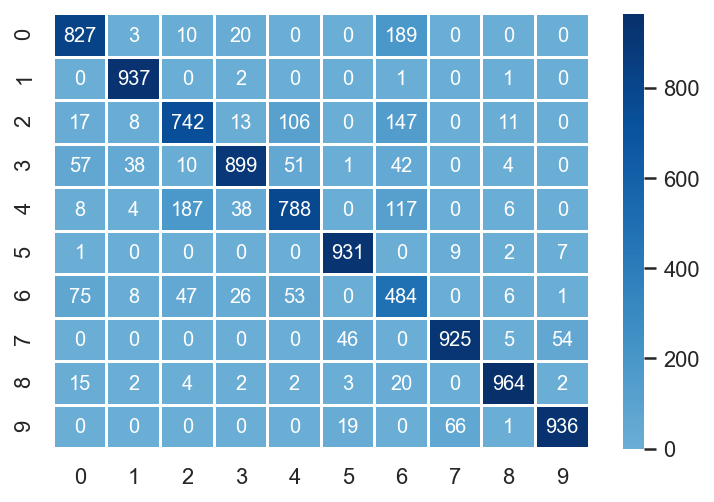

              precision    recall  f1-score   support

           0       0.83      0.79      0.81      1049
           1       0.94      1.00      0.97       941
           2       0.74      0.71      0.73      1044
           3       0.90      0.82      0.86      1102
           4       0.79      0.69      0.73      1148
           5       0.93      0.98      0.95       950
           6       0.48      0.69      0.57       700
           7       0.93      0.90      0.91      1030
           8       0.96      0.95      0.96      1014
           9       0.94      0.92      0.93      1022

    accuracy                           0.84     10000
   macro avg       0.84      0.84      0.84     10000
weighted avg       0.85      0.84      0.85     10000

Wall time: 49.1 s


In [18]:
%%time
y_pred = fit_model(kmeans,flag="add")

cm = confusion_matrix(y_pred,y_test)
sns.heatmap(cm, annot=True, fmt="d", center=0, linewidth=1,cmap="Blues", xticklabels=np.unique(y_train), yticklabels=np.unique(y_train))
plt.show()

print(classification_report(y_pred,y_test))

#### Replace the data with the clusters

C:\Users\manisha\Anaconda3\lib\site-packages\sklearn\metrics\cluster\supervised.py:746: FutureWarning:

The behavior of AMI will change in version 0.22. To match the behavior of 'v_measure_score', AMI will use average_method='arithmetic' by default.



Adjusted Mutual Info Score Train: 50.37
Adjusted Mutual Info Score Test: 50.53
Accuracy of the model is: 58.07%


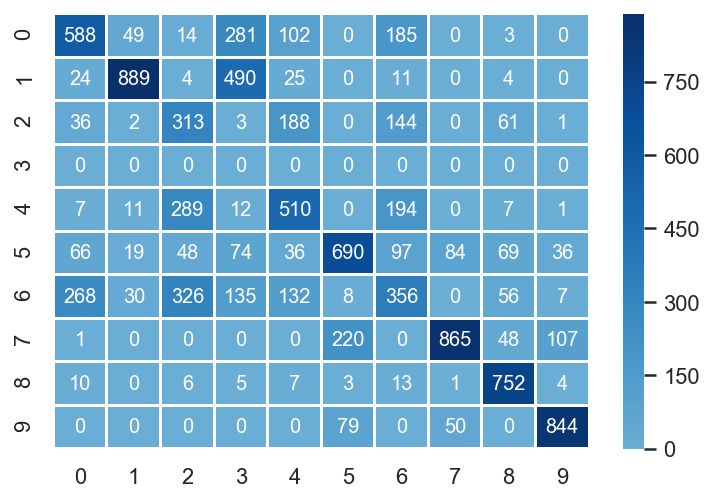

              precision    recall  f1-score   support

           0       0.59      0.48      0.53      1222
           1       0.89      0.61      0.73      1447
           2       0.31      0.42      0.36       748
           3       0.00      0.00      0.00         0
           4       0.51      0.49      0.50      1031
           5       0.69      0.57      0.62      1219
           6       0.36      0.27      0.31      1318
           7       0.86      0.70      0.77      1241
           8       0.75      0.94      0.84       801
           9       0.84      0.87      0.86       973

    accuracy                           0.58     10000
   macro avg       0.58      0.53      0.55     10000
weighted avg       0.66      0.58      0.61     10000

Wall time: 1.98 s


C:\Users\manisha\Anaconda3\lib\site-packages\sklearn\metrics\classification.py:1439: UndefinedMetricWarning:

Recall and F-score are ill-defined and being set to 0.0 in labels with no true samples.



In [20]:
%%time
y_pred = fit_model(kmeans,flag="replace")

cm = confusion_matrix(y_pred,y_test)
sns.heatmap(cm, annot=True, fmt="d", center=0, linewidth=1,cmap="Blues",xticklabels=np.unique(y_train),yticklabels=np.unique(y_train))
plt.show()

print(classification_report(y_pred,y_test))

In [16]:
kmeans_10 = kmeans.fit_predict(X_train.reshape(-1,784))

data = [
    go.Scatter(
        x= x_2[:, 0], 
        y= x_2[:, 1], 
        mode="markers",
        showlegend=False,
        marker=dict(
            size=8,
            color = kmeans_10,
            colorscale = 'Rainbow',
            showscale=False, 
            line = dict(
                width = 2,
                color = 'rgb(255, 255, 255)'
            )))]

layout = go.Layout(
    title= 'KMeans Clustering',
    hovermode= 'closest',
    xaxis= dict(
         title= 'First Principal Component',
        ticklen= 8,
        zeroline= False,
        gridwidth= 2,
    ),
    yaxis=dict(
        title= 'Second Principal Component',
        ticklen= 8,
        gridwidth= 2,
    ),
    showlegend= True
)

fig = dict(data = data, layout = layout)
pyo.iplot(fig, filename="kmeans_plot")

### LDA - Linear Discriminant Analysis

In [17]:
from sklearn.discriminant_analysis import LinearDiscriminantAnalysis as LDA
lda = LDA(n_components=2)
x_lda = lda.fit_transform(X_train.reshape(-1,784),y_train)

In [18]:
data = [
        go.Scatter(
            x = x_lda[:,0],
            y = x_lda[:,1],
            mode = 'markers',
            showlegend = True,
            marker = dict(
                size = 8,
                color = y_train,
                colorscale = 'Rainbow',
                showscale = False,
                opacity = 0.8,
                line = dict(
                    width = 2,
                    color = 'rgb(255, 255, 255)'
                )
            )
        )]

layout = go.Layout(
    title = 'Linear Discriminant Analysis (LDA)',
    hovermode = "closest",
    xaxis = dict(
        title = 'First Linear Discriminant',
        ticklen = 8,
        zeroline = False,
        gridwidth = 2
    ),
    yaxis = dict(
        title = 'Second Linear Discriminant',
        ticklen = 8,
        gridwidth = 2
    ),
    showlegend = False
)

fig = dict(data = data, layout = layout)
pyo.iplot(fig, filename='lda_plot')

### TSNE - T-distributed Stochastic Neighbour Embedding

In [ ]:
from sklearn.manifold import TSNE
tsne = TSNE()
x_tsne = tsne.fit_transform(X_train.reshape(-1,784)[:2000])

In [ ]:
data = [
        go.Scatter(
            x = x_tsne[:, 0][:2000],
            y = x_tsne[:, 1][:2000],
            mode = 'markers',
            showlegend = True,
            marker = dict(
                size = 8,
                color = y_train[:2000],
                colorscale = 'Rainbow',
                showscale = False,
                opacity = 0.8,
                line = dict(
                    width = 2,
                    color = 'rgb(255,255,255)'
                )
            )
        )]

layout = dict(
    title = 'TSNE (T-Distributed Stochastic Neighbour Embedding)',
    hovermode = 'closest',
    yaxis = dict(zeroline = False),
    xaxis = dict(zeroline = False),
    showlegend = False
)

fig = dict(data = data, layout = layout)
pyo.iplot(fig, filename='TSNE_plot')